Basado en capitulo 02 de fastbook con fastai

**Objetivo**: Clasificar imagenes de Margaritas, Dama de la noche y Rosas

# Inicio


In [2]:
!git clone https://github.com/DataScienceandAIVE/fastbook
%cd fastbook
!pip install -q -r requirements.txt

Cloning into 'fastbook'...
remote: Enumerating objects: 81, done.
remote: Counting objects: 100% (81/81), done.
remote: Compressing objects: 100% (52/52), done.
remote: Total 1494 (delta 41), reused 46 (delta 29), pack-reused 1413
Receiving objects: 100% (1494/1494), 77.16 MiB | 13.47 MiB/s, done.
Resolving deltas: 100% (812/812), done.
/content/fastbook
     |████████████████████████████████| 194kB 2.8MB/s 
     |████████████████████████████████| 51kB 5.4MB/s 
     |████████████████████████████████| 51kB 5.3MB/s 
     |████████████████████████████████| 1.1MB 11.7MB/s 
     |████████████████████████████████| 40kB 5.5MB/s 
     |████████████████████████████████| 92kB 7.5MB/s 
     |████████████████████████████████| 61kB 6.6MB/s 
     |████████████████████████████████| 51kB 6.8MB/s 
     |████████████████████████████████| 2.7MB 18.2MB/s 


In [0]:
from utils import *
from fastai2.vision.widgets import *

In [0]:
key = "" #KEY para Bing image search

In [6]:
search_images_bing

<function utils.search_images_bing>

# Datos

In [0]:
flower_types = 'lady_of_the_night', 'rose', 'daisy'
path = Path('flowers')

In [0]:
#Guardar en cada carpeta de categoria las imagenes
if not path.exists():
    path.mkdir()
    for o in flower_types:
        dest = (path/o)
        dest.mkdir(exist_ok=True)
        results = search_images_bing(key, f'{o} flower')
        download_images(dest, urls=results.attrgot('content_url'))


In [12]:
fns = get_image_files(path)
fns

(#447) [Path('flowers/lady_of_the_night/00000064.jpg'),Path('flowers/lady_of_the_night/00000077.jpg'),Path('flowers/lady_of_the_night/00000137.jpg'),Path('flowers/lady_of_the_night/00000034.jpg'),Path('flowers/lady_of_the_night/00000103.jpg'),Path('flowers/lady_of_the_night/00000030.jpg'),Path('flowers/lady_of_the_night/00000099.jpg'),Path('flowers/lady_of_the_night/00000039.jpg'),Path('flowers/lady_of_the_night/00000042.jpg'),Path('flowers/lady_of_the_night/00000059.jpg')...]

In [13]:
#verifiquemos integridad de las imagenes
failed = verify_images(fns)
failed

(#1) [Path('flowers/rose/00000050.jpg')]

In [0]:
#Eliminamos las imagenes erroneas
failed.map(Path.unlink);

# DataLoader

In [0]:
#Preparamos el DataLoader
flowers = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.2, seed=13),
    get_y=parent_label,
    item_tfms=Resize(128))

In [0]:
dls = flowers.dataloaders(path) #Creamos el DataLoader

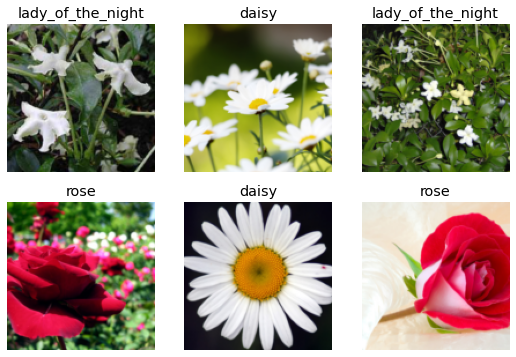

In [26]:
dls.valid.show_batch(max_n=6, nrows=2)

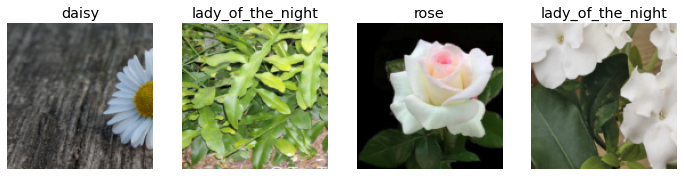

In [29]:
#Prueba con Rescalado y cortes aleatorios
flowers = flowers.new(item_tfms=RandomResizedCrop(128, min_scale=0.3))
dls = flowers.dataloaders(path)
dls.train.show_batch(max_n=4, nrows=1, unique=False)

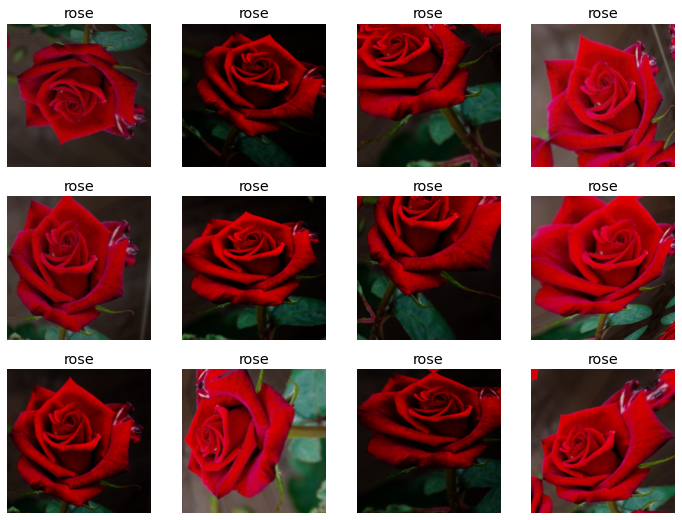

In [52]:
#Probando Data Augmentation
flowers = flowers.new(item_tfms=RandomResizedCrop(224, min_scale=0.5), batch_tfms=aug_transforms(mult=2, flip_vert=True, max_rotate=20.0, p_lighting=1.0))
dls = flowers.dataloaders(path)
dls.train.show_batch(max_n=12, nrows=3, unique=True)

# 1er Entrenamiento


In [53]:
#Comenzamos el entrenamiento
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(4)

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/checkpoints/resnet18-5c106cde.pth


epoch,train_loss,valid_loss,error_rate,time
0,1.271386,0.183121,0.033708,01:22


epoch,train_loss,valid_loss,error_rate,time
0,0.287266,0.149978,0.044944,01:43
1,0.212599,0.126944,0.044944,01:42
2,0.193363,0.120420,0.033708,01:43
3,0.160583,0.123637,0.033708,01:43


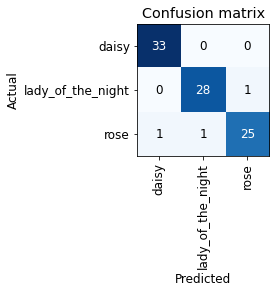

In [54]:
#Visualizaremos los errores cometidos con una Matrix de confusion
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

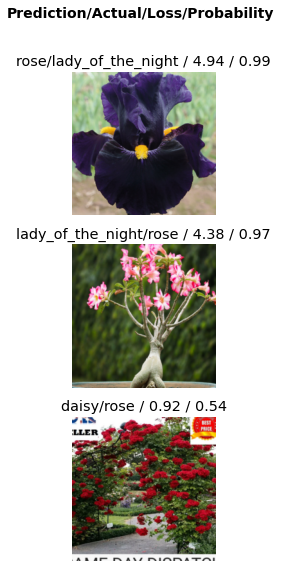

In [58]:
#Mostrar imagenes con mayor perdida/impresion (top 3 ya que fue la cantidad de la matriz)
interp.plot_top_losses(3, nrows=3)

# Limpieza de datos

In [59]:
#GUI para limpiar datos de cada conjunto
cleaner = ImageClassifierCleaner(learn)
cleaner

In [61]:
#Eliminar del dataset segun eleccion en GUI (Debimos hacerlo al principio)
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), path/cat)

FileNotFoundError: ignored

# 2da Entrenamiento

In [0]:
#Vuelvo a prepara el DataLoader
flowers = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.2, seed=5),
    get_y=parent_label,
    item_tfms=Resize(128))

In [0]:
dls = flowers.dataloaders(path) #Creamos el DataLoader

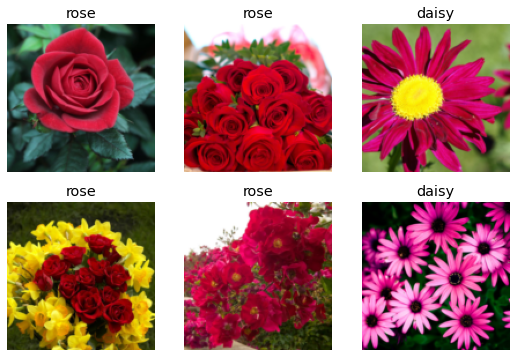

In [67]:
#Un vistazo al conjunto
dls.valid.show_batch(max_n=6, nrows=2) 

In [68]:
#Vuelvo a entrenar tras limpiar
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(4)

epoch,train_loss,valid_loss,error_rate,time
0,1.344345,0.527894,0.147727,00:36


epoch,train_loss,valid_loss,error_rate,time
0,0.486389,0.173785,0.056818,00:45
1,0.315043,0.131228,0.068182,00:45
2,0.215173,0.050579,0.022727,00:45
3,0.165097,0.036652,0.011364,00:46


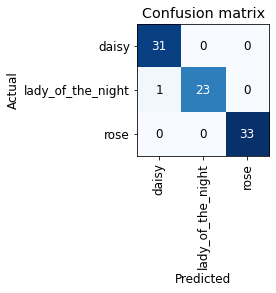

In [69]:
#Visualizaremos los errores cometidos con una Matrix de confusion
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

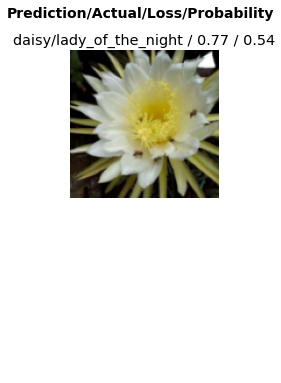

In [72]:
#Mostrar imagenes con mayor perdida/impresion (top 1 ya que fue la cantidad de la matriz)
interp.plot_top_losses(1, nrows=2)

# Prediccion / Export

In [0]:
#exportamos
learn.export('trained_model_flowers.pkl')

In [77]:
path = Path()
path.ls(file_exts='.pkl')

(#1) [Path('trained_model_flowers.pkl')]

In [0]:
#Cargamos modelo
learn_inf = load_learner(path/'trained_model_flowers.pkl')

In [81]:
#Tras cargar foto propia de una flor >>
learn_inf.predict('flowers/DamaDeLaNoche.jpeg')

('lady_of_the_night', tensor(1), tensor([5.4654e-07, 9.9997e-01, 2.8466e-05]))

In [82]:
learn_inf.dls.vocab

(#3) ['daisy','lady_of_the_night','rose']

# Funcion para predecir desde una url


In [0]:
def predict_from_url(url):
  ims = [url]
  dest = "flowers/test.jpg"
  download_url(ims[0], dest, True)
  show_img(dest)
  pred = learn_inf.predict(dest)
  print(f'Es una {pred[0]} con la prob {pred[2][pred[1]] * 100}%')

In [130]:
predict_from_url('https://th.bing.com/th/id/OIP.FYiuLmG_OgUvfIhKRwbZzAHaE8?pid=Api&rs=1')

Es una daisy con la prob 99.6303939819336%
